In [1]:
import tensorflow as tf

In [2]:
# define style and content weight
style_weight = 1e-4
content_weight = 1e-32

In [3]:
optimizer = tf.optimizers.Adam(
                               tf.keras.optimizers.schedules.ExponentialDecay(
                                                                              initial_learning_rate=30.0,
                                                                              decay_steps=100,
                                                                              decay_rate=0.80)
                               )

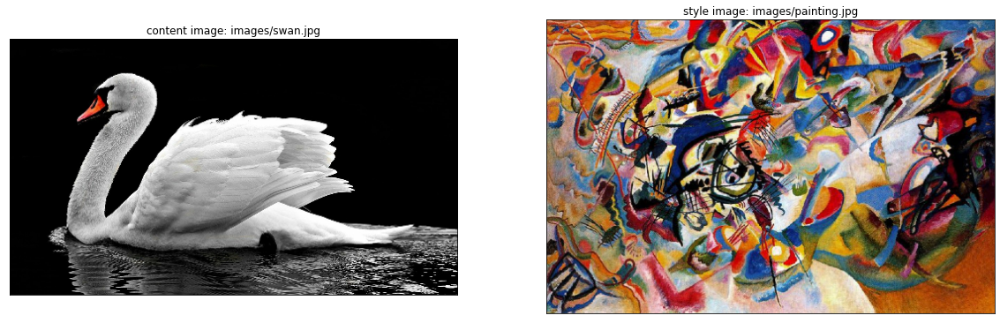

In [4]:
from main_script import style_image, content_image, vgg, num_style_layer, num_content_layer

In [5]:
epochs = 10
steps_per_epoch = 100
var_weight = 0

In [6]:
from getting_image_features import get_style_layers_feature, get_content_layers_feature

In [7]:
images = []
steps = 0

In [8]:
style_targets = get_style_layers_feature(style_image, vgg, num_style_layer)

In [9]:
content_targets = get_content_layers_feature(content_image, vgg, num_content_layer)

In [10]:
# Initialize generated image for update
generated_image = tf.cast(content_image, tf.float32)
generated_image = tf.Variable(generated_image)
# Here tf.Varible means this varible can be updated

In [11]:
images.append(content_image)

In [12]:
len(images)

1

In [13]:
from loss_calculation import get_content_loss, get_style_loss

In [14]:
from imageio import mimsave
from IPython.display import display as display_fn
from IPython.display import Image, clear_output

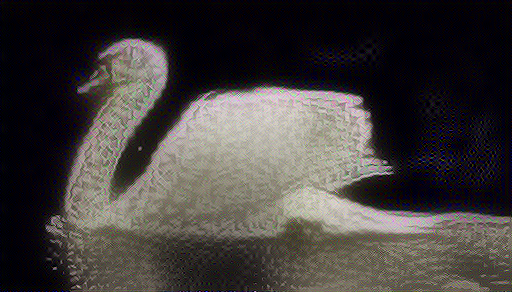

Train step: 1000


In [21]:
images = []
steps = 0
style_targets = get_style_layers_feature(style_image, vgg, num_style_layer)
content_targets = get_content_layers_feature(content_image, vgg, num_content_layer)
# Initialize generated image for update
generated_image = tf.cast(content_image, tf.float32)
generated_image = tf.Variable(generated_image)
# Here tf.Varible means this varible can be updated

images.append(content_image)
for i in range(epochs):
    
    for steps_ in range(steps_per_epoch):
        steps +=1
        print(steps_)
        #gradients = calculate_gradients(generated_image, style_targets, content_targets, 
                                  #style_weight, content_weight, var_weight)
        with tf.GradientTape() as tape:
            style_features = get_style_layers_feature(generated_image, vgg, num_style_layer)
            content_features = get_content_layers_feature(generated_image, vgg, num_content_layer)
            style_loss = tf.add_n([get_style_loss(style_output, style_target) for style_output, \
                                   style_target in zip(style_features, style_targets)])
            
            content_loss = tf.add_n([get_content_loss(content_output, content_target) for content_output, \
                                     content_target in zip(content_features, content_targets) ])
            
            style_loss = (style_loss * style_weight)/ num_style_layer
            content_loss = (content_loss * content_weight) / num_content_layer
            
            loss = total_loss = content_loss + style_loss
        gradients = tape.gradient(loss, generated_image)
        optimizer.apply_gradients([(gradients, generated_image)])
        generated_image.assign(tf.clip_by_value(generated_image, clip_value_min=0.0, clip_value_max=255.0))
        
        print(".", end='')
        
        
                               
        if (steps_ + 1) % 10 == 0:
             images.append(generated_image)
    clear_output(wait=True)
    display_image = tensor_to_image(generated_image)
    display_fn(display_image)
        
    images.append(generated_image)
    print("Train step: {}".format(steps))
generated_image = tf.cast(generated_image, dtype=tf.uint8)
        
            
        

In [15]:
def tensor_to_image(tensor):
  '''converts a tensor to an image'''
  tensor_shape = tf.shape(tensor)
  number_elem_shape = tf.shape(tensor_shape)
  if number_elem_shape > 3:
    assert tensor_shape[0] == 1
    tensor = tensor[0]
  return tf.keras.preprocessing.image.array_to_img(tensor) 


In [18]:
len(images)

111

In [23]:
import numpy as np

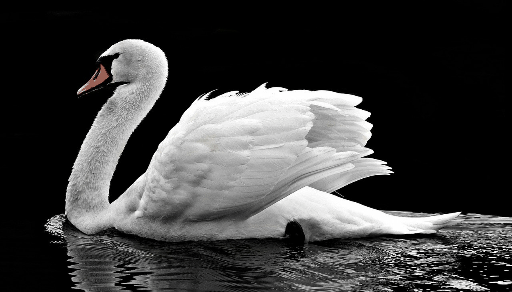

In [28]:
# display GIF of Intermedite Outputs
GIF_PATH = 'style_transfer.gif'
gif_images = [np.squeeze(image.numpy().astype(np.uint8), axis=0) for image in images]
gif_path = create_gif(GIF_PATH, gif_images)
display_gif(gif_path)

In [25]:

def create_gif(gif_path, images):
  '''creates animation of generated images'''
  mimsave(gif_path, images, fps=1)
  
  return gif_path

In [27]:
def display_gif(gif_path):
  '''displays the generated images as an animated gif'''
  with open(gif_path,'rb') as f:
    display_fn(Image(data=f.read(), format='png'))
